In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import harmonypy as hm
import anndata
import os
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
from scipy import io
import scvelo as scv

sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')

# set random seed for reproducibility:
np.random.seed(42)


In [2]:
# set working dir 
os.chdir('/dfs3b/swaruplab/shared_lab/cross-disorder/analysis/individual/Leng_2021')

fig_dir = 'figures/'
data_dir = 'data/'


In [ ]:
adata = sc.read_h5ad("/dfs3b/swaruplab/shared_lab/cross-disorder/analysis/individual/Leng_2021/data/Leng_2021_unfiltered.h5ad")


In [3]:
adata.obs.brain_region.value_counts()

NameError: name 'adata' is not defined

## Load Leng et al 2021 AD dataset:

In [3]:
count_data_dir = '/dfs3b/swaruplab/shared_lab/cross-disorder/count_matrices/AD_Leng_2021/'
samples = [s for s in os.listdir(count_data_dir)]
adata_list = []
for sample in samples:
    try:
        adata = sc.read_h5ad('{}{}/scanpy_preprocessing_cellbender/data/adata_unfiltered.h5ad'.format(count_data_dir, sample))
    except:
        print('sample', sample, ' error')
        continue
    adata.obs['Sample'] = sample
    adata.obs['Study'] = 'Leng_2021'
    adata.obs['orig_barcode'] = adata.obs.index

    adata_list.append(adata)

    print(sample, adata.layers['spliced'].shape)


SRR11422702 (5433, 36601)
SRR11422710 (3305, 36601)
SRR11422716 (11598, 36601)
SRR11422707 (10771, 36601)
SRR11422719 (9219, 36601)
SRR11422705 (5332, 36601)
SRR11422704 (7182, 36601)
SRR11422712 (7156, 36601)
SRR11422711 (11712, 36601)
SRR11422717 (12463, 36601)
SRR11422713 (5359, 36601)
SRR11422700 (10561, 36601)
SRR11422709 (9257, 36601)
SRR11422701 (3820, 36601)
SRR11422715 (5309, 36601)
SRR11422714 (8271, 36601)
SRR11422718 (11729, 36601)
SRR11422703 (7759, 36601)
SRR11422708 (14504, 36601)
SRR11422706 (7067, 36601)


In [4]:
# concatenate
adata = adata_list[0].concatenate(adata_list[1:])
adata.obs['barcode'] = adata.obs.index

# filter small cells
sc.pp.filter_cells(adata, min_counts = 250)

# add counts layer
adata.layers["counts"] = adata.X.copy()

# drop "batch" column:
adata.obs = adata.obs.drop('batch', axis=1)

# print shape of dataset
adata.shape


(147967, 36601)

In [5]:
# load biospecimen table
sample_meta = pd.read_csv(
    '/dfs3b/swaruplab/shared_lab/cross-disorder/meta_data/AD_Leng/SRR_raw.txt',
    sep=','
)

# only keep important columns:
sample_meta = sample_meta[['Run', 'batch', 'brain_region', 'donor_id', 'sex']]


temp = adata.obs.merge(
    sample_meta,
    how = 'left',
    left_on = 'Sample',
    right_on = 'Run'
)
temp.index = temp.barcode
adata.obs = temp
adata.obs.index.name = None



In [6]:
# load table 1 from their paper
sample_meta = pd.read_csv(
    'data/Leng_NatNeuro_table1.csv',
    sep=','
)

sample_meta = sample_meta.rename(
    {
        'Participant no.': 'donor_id',
        'Braak stage': "braak",
        'Age at death (years)': 'age',
        'Postmortem interval (h)': 'PMI',
        'ADNC score': 'ADNC_score',
        'CDR before death': 'CDR',
        'APOE genotype': 'APOE'
    }, 
axis=1)


temp = adata.obs.merge(
    sample_meta,
    how = 'left',
    left_on = 'donor_id',
    right_on = 'donor_id'
)
temp.index = temp.barcode
adata.obs = temp
adata.obs.index.name = None



In [7]:
adata.obs.head()

,orig_barcode,n_counts,doublet_scores,doublets,Sample,Study,barcode,Run,batch,brain_region,donor_id,sex,braak,Sex,age,PMI,ADNC_score,CDR,APOE genotype,Source
AGCAGCCTCCTTTCTC-0,AGCAGCCTCCTTTCTC,27481.0,0.150350,Singlet,SRR11422702,Leng_2021,AGCAGCCTCCTTTCTC-0,SRR11422702,C,Superior frontal gyrus,3,male,0,M,71,12.0,"A1, B0, C0",0.0,ε3/ε3,BBAS
TCTTCGGAGCGCCTTG-0,TCTTCGGAGCGCCTTG,22968.0,0.074860,Singlet,SRR11422702,Leng_2021,TCTTCGGAGCGCCTTG-0,SRR11422702,C,Superior frontal gyrus,3,male,0,M,71,12.0,"A1, B0, C0",0.0,ε3/ε3,BBAS
CCAATCCTCCCGGATG-0,CCAATCCTCCCGGATG,17884.0,0.036741,Singlet,SRR11422702,Leng_2021,CCAATCCTCCCGGATG-0,SRR11422702,C,Superior frontal gyrus,3,male,0,M,71,12.0,"A1, B0, C0",0.0,ε3/ε3,BBAS
CGGACACAGAATCTCC-0,CGGACACAGAATCTCC,13977.0,0.178571,Singlet,SRR11422702,Leng_2021,CGGACACAGAATCTCC-0,SRR11422702,C,Superior frontal gyrus,3,male,0,M,71,12.0,"A1, B0, C0",0.0,ε3/ε3,BBAS
ATCCGAAAGTGCTGCC-0,ATCCGAAAGTGCTGCC,12949.0,0.205298,Singlet,SRR11422702,Leng_2021,ATCCGAAAGTGCTGCC-0,SRR11422702,C,Superior frontal gyrus,3,male,0,M,71,12.0,"A1, B0, C0",0.0,ε3/ε3,BBAS


In [8]:
# save unfiltered dataset:
adata.write_h5ad('{}Leng_2021_unfiltered.h5ad'.format(data_dir))


... storing 'orig_barcode' as categorical
... storing 'doublets' as categorical
... storing 'Sample' as categorical
... storing 'Study' as categorical
... storing 'Run' as categorical
... storing 'batch' as categorical
... storing 'brain_region' as categorical
... storing 'sex' as categorical
... storing 'Sex' as categorical
... storing 'ADNC_score' as categorical
... storing 'APOE\xa0genotype' as categorical
... storing 'Source' as categorical


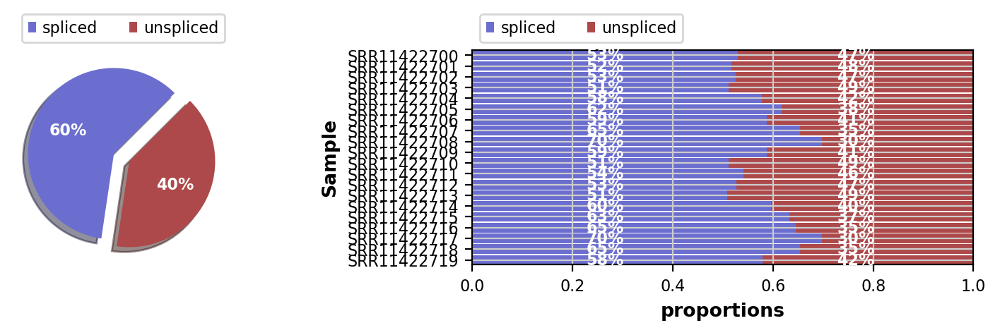

In [9]:
scv.pl.proportions(adata, groupby='Sample')

# SFG Processing

For this study we are doing two separate analyses since they have two distinct brain regions.

## QC Filtering


In [10]:
# load unfiltered data 
adata = sc.read_h5ad('{}Leng_2021_unfiltered.h5ad'.format(data_dir))

# get just the SFG samples:
adata = adata[adata.obs.brain_region == 'Superior frontal gyrus']
adata.shape

(77886, 36601)

In [11]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=True, inplace=True)

Trying to set attribute `.var` of view, copying.


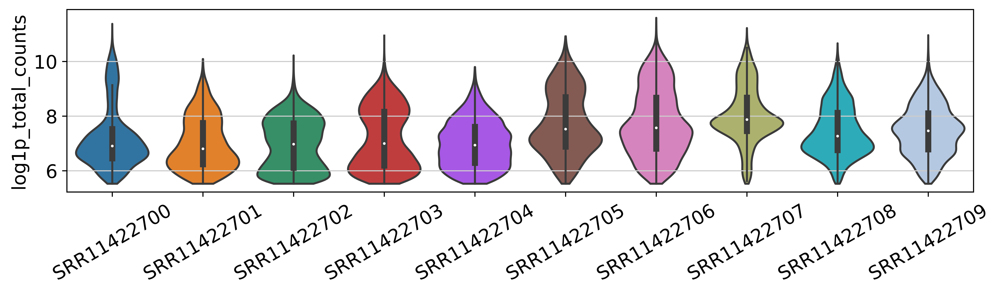

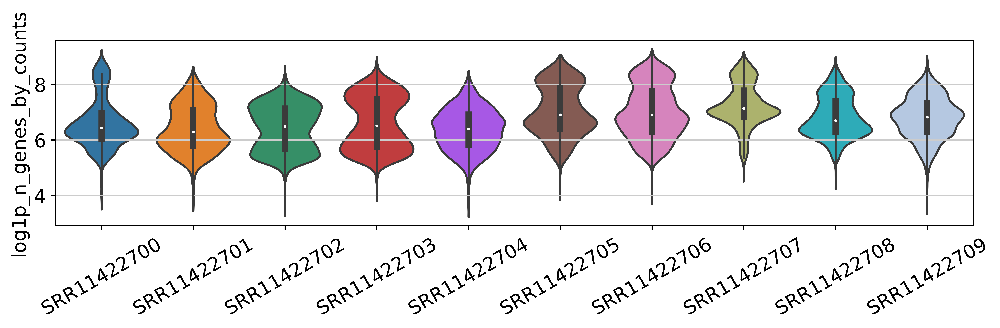

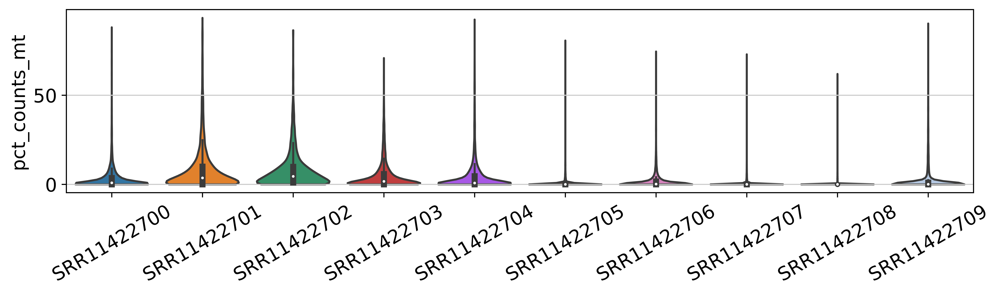

In [12]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'log1p_n_genes_by_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)

In [13]:

mt_quantile = 0.95
umi_quantile = 0.95
doublet_quantile = 0.95

samples = adata.obs.Sample.value_counts().index.to_list()
good_barcodes = []
for cur_sample in samples:
    
    # get just this sample
    cur_adata = adata[adata.obs.Sample == cur_sample]
    orig_cells = cur_adata.shape[0]
    
    # compute cutoffs for each sample
    mt_cutoff = cur_adata.obs.pct_counts_mt.quantile(mt_quantile)
    umi_cutoff = cur_adata.obs.total_counts.quantile(umi_quantile)
    doublet_cutoff = cur_adata.obs.doublet_scores.quantile(doublet_quantile)
    
    # subset the data based on thresholds
    cur_adata = cur_adata[(cur_adata.obs.pct_counts_mt < mt_cutoff) & (cur_adata.obs.total_counts < umi_cutoff) & (cur_adata.obs.doublet_scores < doublet_cutoff)]
    new_cells = cur_adata.shape[0]
    
    keep_cells = cur_adata.obs.barcode.to_list() 
    good_barcodes = good_barcodes + keep_cells
    print(cur_sample, 'removed ', orig_cells-new_cells, ', kept ', new_cells)

    

SRR11422708 removed  2030 , kept  12310
SRR11422707 removed  1552 , kept  9158
SRR11422700 removed  1540 , kept  8786
SRR11422709 removed  1316 , kept  7777
SRR11422706 removed  1029 , kept  5976
SRR11422703 removed  1034 , kept  5896
SRR11422704 removed  980 , kept  5677
SRR11422705 removed  770 , kept  4526
SRR11422702 removed  638 , kept  3489
SRR11422701 removed  523 , kept  2879


In [14]:
# subset the full data by the good barcodes
adata = adata[adata.obs.index.isin(good_barcodes)]
adata.shape

(66474, 36601)

In [15]:
adata = adata[adata.obs.n_genes_by_counts >= 250]
adata = adata[adata.obs.pct_counts_mt <= 10]

adata.shape

(60108, 36601)

## Process SFG dataset:

In [16]:
# preserve the counts in its own layer
adata.layers['counts'] = adata.X

In [17]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

In [18]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'], n_jobs=16)
sc.pp.scale(adata, max_value=10)

In [19]:
sc.tl.pca(adata, svd_solver='arpack')

In [20]:
adata.obs.batch.value_counts()

C    16722
D    16502
A    14734
B    12150
Name: batch, dtype: int64

In [21]:
# run harmony
sc.external.pp.harmony_integrate(adata, key = 'Sample')

2022-03-07 10:17:20,088 - harmonypy - INFO - Iteration 1 of 10
2022-03-07 10:17:46,569 - harmonypy - INFO - Iteration 2 of 10
2022-03-07 10:18:11,522 - harmonypy - INFO - Iteration 3 of 10
2022-03-07 10:18:36,945 - harmonypy - INFO - Iteration 4 of 10
2022-03-07 10:19:02,794 - harmonypy - INFO - Iteration 5 of 10
2022-03-07 10:19:26,609 - harmonypy - INFO - Iteration 6 of 10
2022-03-07 10:19:48,264 - harmonypy - INFO - Iteration 7 of 10
2022-03-07 10:20:03,516 - harmonypy - INFO - Converged after 7 iterations


In [22]:
sc.pp.neighbors(adata, use_rep = 'X_pca_harmony', n_neighbors=20, n_pcs=30, metric='cosine')

In [23]:
sc.tl.umap(adata, min_dist=0.35, method='umap')

In [24]:
sc.tl.leiden(adata, resolution=1)

#compute dendrogram for the dotplot:
sc.tl.dendrogram(adata, 'leiden')

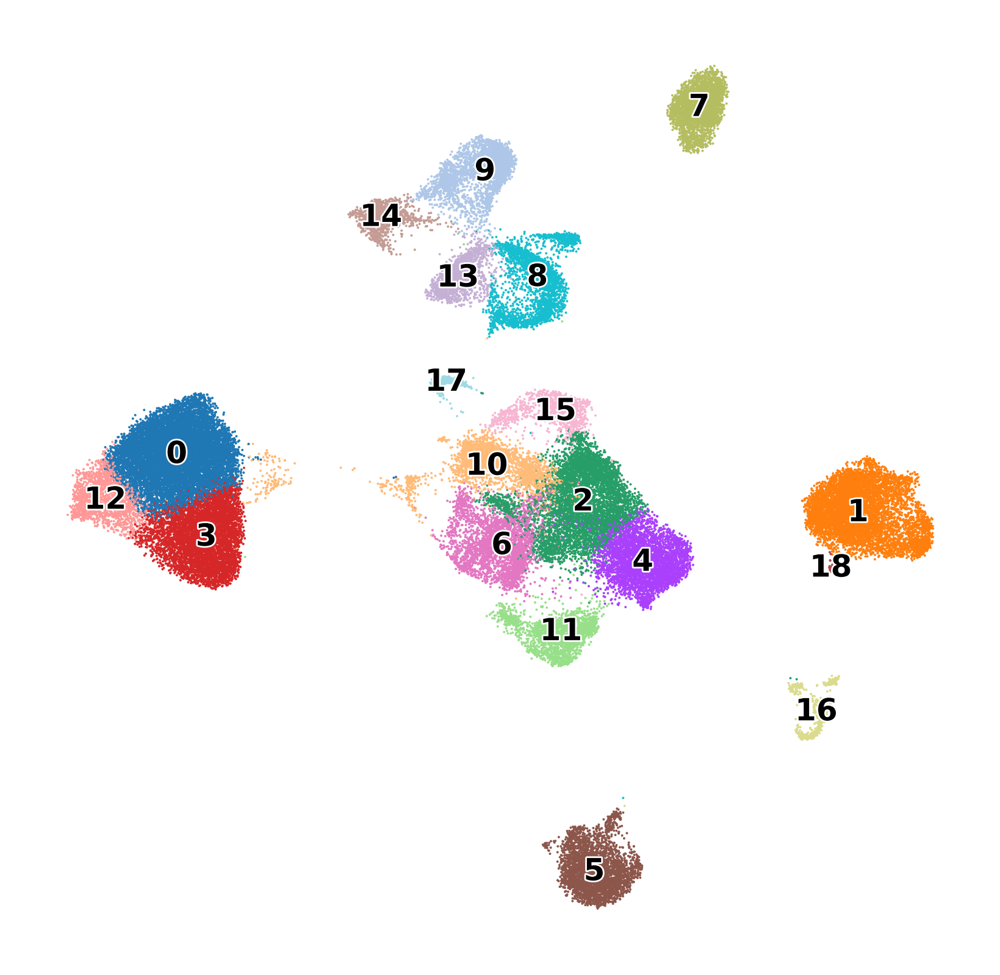

In [25]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['leiden'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    title='',
    save='_SFG_leiden.pdf'
)


categories: 0, 1, 2, etc.
var_group_labels: Oligodendrocyte, Astrocyte, Microglia, etc.


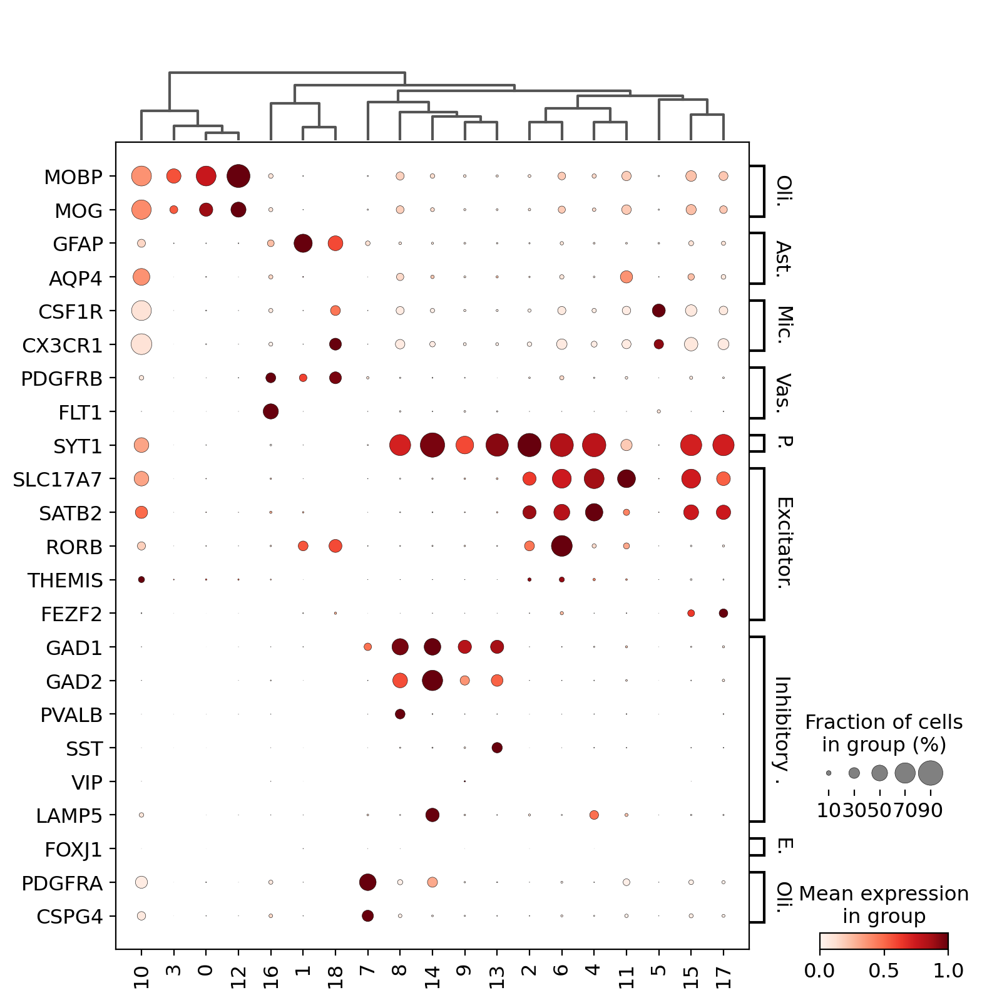

In [26]:
marker_dict = {
    'Oligodendrocyte': ['MOBP', 'MOG'],
    'Astrocyte': ['GFAP', 'AQP4'],
    'Microglia': ['CSF1R', 'CX3CR1',],
    'Vasculature': ['PDGFRB', 'FLT1'],
    'Pan-neuronal': ['SYT1'],
    'Excitatory Neuron': ['SLC17A7', 'SATB2', 'RORB', 'THEMIS', 'FEZF2'],
    'Inhibitory Neuron': ['GAD1', 'GAD2', 'PVALB', 'SST', 'VIP', 'LAMP5'],
    'Ependyma' : ['FOXJ1'], # not expressed
    'Oligodendrocyte Progenitor': ['PDGFRA', 'CSPG4']
}

sc.set_figure_params(dpi=100)
sc.pl.dotplot(
    adata, marker_dict, 'leiden', 
    dendrogram=True, 
    standard_scale='var', swap_axes=True
)


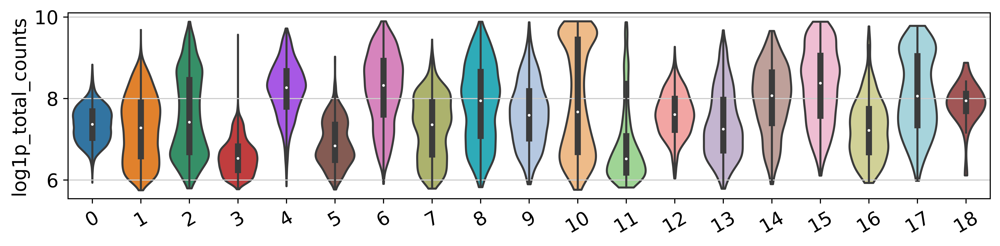

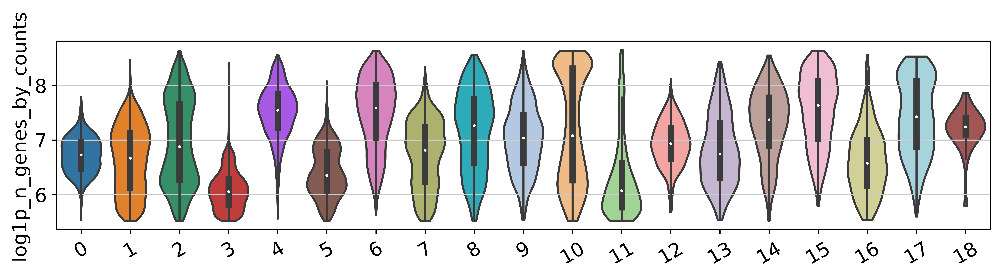

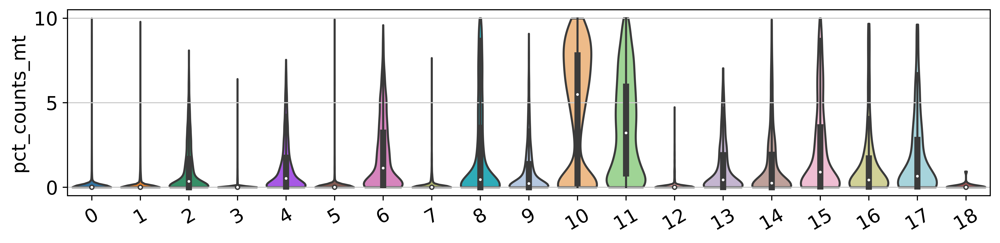

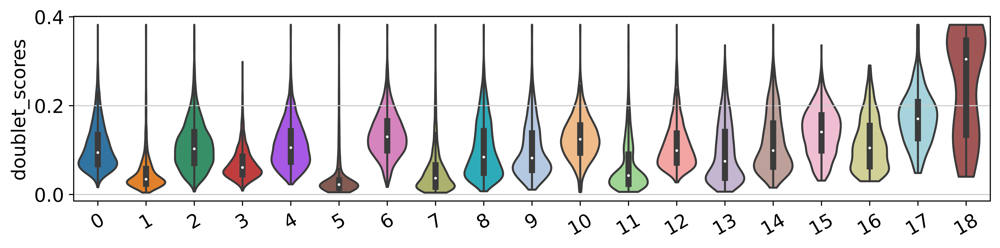

In [27]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'log1p_n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'doublet_scores'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)

## Annotate clusters:

In [28]:

# load cluster anno df 
anno_df = pd.read_csv('data/Leng_2021_leiden_clusters.csv')

anno_df.leiden = anno_df.leiden.astype(str)
temp = adata.obs.merge(
    anno_df, how='left',
    on = 'leiden')

adata.obs['cell_type'] = temp['cell_type'].astype(str).to_list()
adata.obs['annotation'] = temp['annotation'].astype(str).to_list()



In [29]:
# remove unknown & doublet clusters
clusters_to_remove = ['Unknown', 'Doublet']
adata = adata[~adata.obs.annotation.isin(clusters_to_remove)]


In [30]:
# re-make umap 
sc.tl.umap(adata, min_dist=0.35, method='umap')

Trying to set attribute `.uns` of view, copying.


... storing 'cell_type' as categorical
... storing 'annotation' as categorical


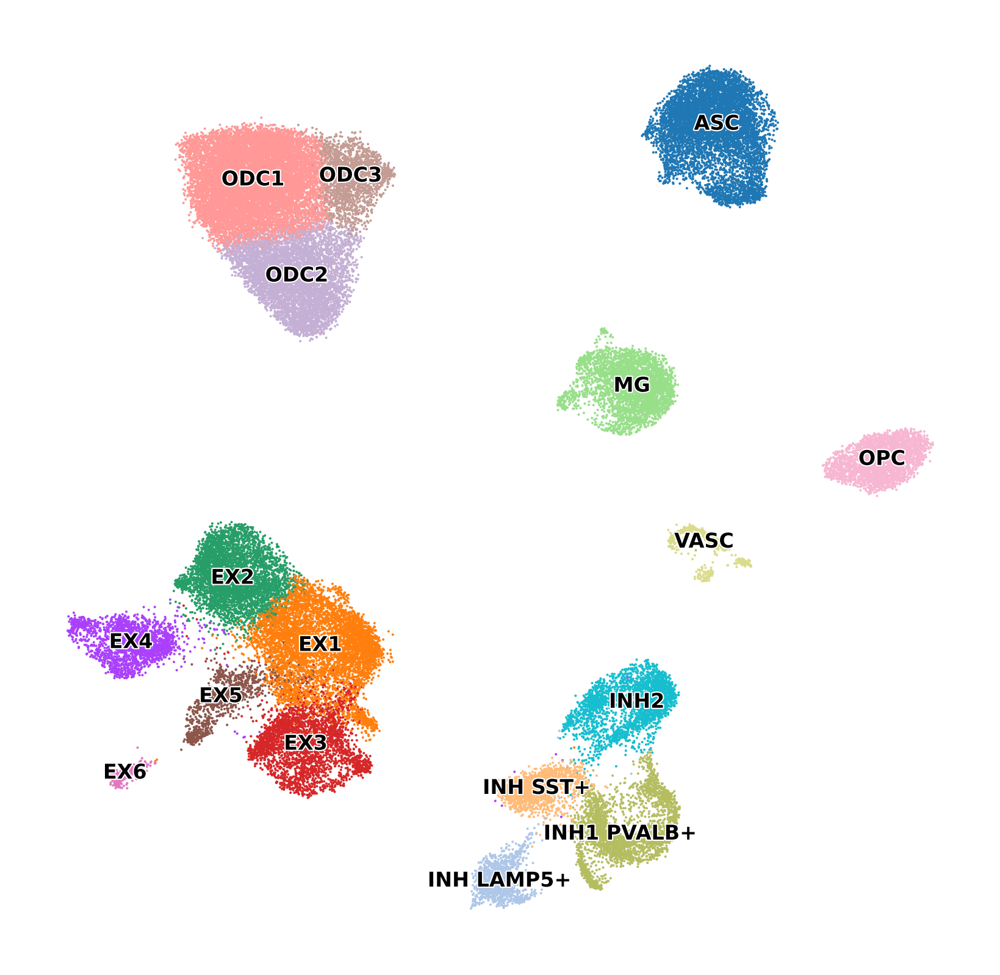

In [31]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=.75, 
    legend_fontsize=6, 
    title='',
    save='_SFG_annotation.pdf'
)


## Save processed dataset:

In [32]:
# write obs table 
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]
adata.obs.to_csv('{}/Leng_2021_SFG_processed_obs.csv'.format(data_dir))

# write var table:
adata.var.to_csv('{}/Leng_2021_SFG_processed_var.csv'.format(data_dir))

In [33]:
# write anndata:
adata.write_h5ad('{}/Leng_2021_SFG_processed.h5ad'.format(data_dir))

In [34]:
# save the sparse matrix for Seurat:
X = adata.layers['counts']
X = scipy.sparse.csr_matrix.transpose(X)
io.mmwrite('{}/Leng_2021_SFG_counts.mtx'.format(data_dir), X)

In [35]:
# save the Harmony Matrix for Seurat:
pd.DataFrame(adata.obsm['X_pca_harmony']).to_csv('{}/Leng_2021_SFG_processed_harmony.csv'.format(data_dir))


# Process EC dataset:

## QC filtering:

In [36]:
# load unfiltered data 
adata = sc.read_h5ad('{}Leng_2021_unfiltered.h5ad'.format(data_dir))

# get just the SFG samples:
adata = adata[adata.obs.brain_region == 'Entorhinal cortex']
adata.shape

(70081, 36601)

In [37]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=True, inplace=True)

Trying to set attribute `.var` of view, copying.


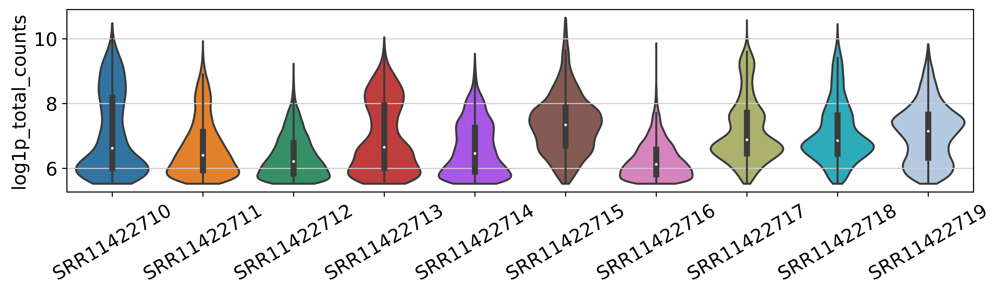

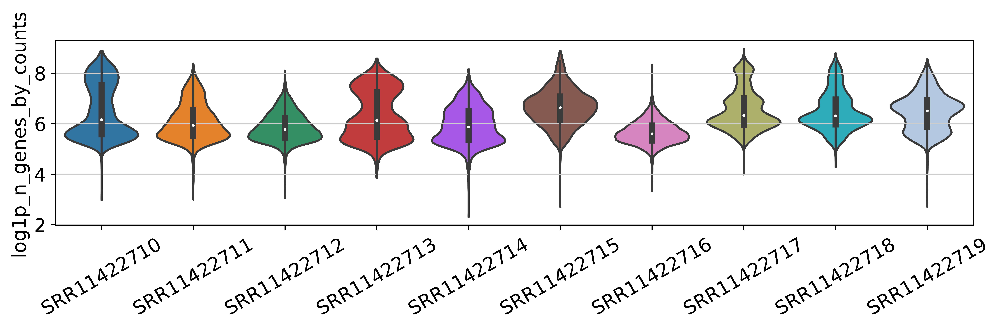

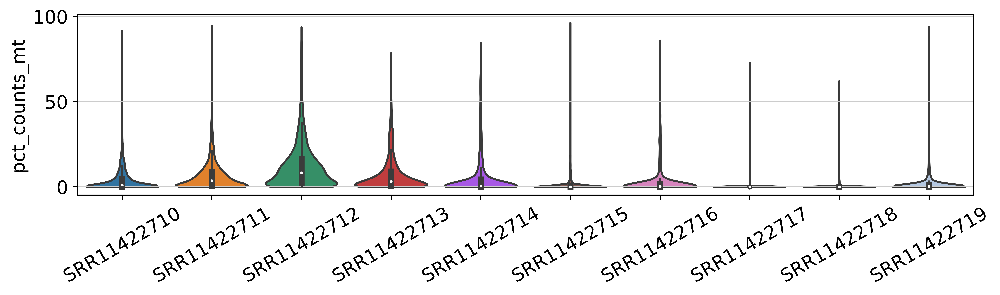

In [38]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'log1p_n_genes_by_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)

In [39]:

mt_quantile = 0.95
umi_quantile = 0.95
doublet_quantile = 0.95

samples = adata.obs.Sample.value_counts().index.to_list()
good_barcodes = []
for cur_sample in samples:
    
    # get just this sample
    cur_adata = adata[adata.obs.Sample == cur_sample]
    orig_cells = cur_adata.shape[0]
    
    # compute cutoffs for each sample
    mt_cutoff = cur_adata.obs.pct_counts_mt.quantile(mt_quantile)
    umi_cutoff = cur_adata.obs.total_counts.quantile(umi_quantile)
    doublet_cutoff = cur_adata.obs.doublet_scores.quantile(doublet_quantile)
    
    # subset the data based on thresholds
    cur_adata = cur_adata[(cur_adata.obs.pct_counts_mt < mt_cutoff) & (cur_adata.obs.total_counts < umi_cutoff) & (cur_adata.obs.doublet_scores < doublet_cutoff)]
    new_cells = cur_adata.shape[0]
    
    keep_cells = cur_adata.obs.barcode.to_list() 
    good_barcodes = good_barcodes + keep_cells
    print(cur_sample, 'removed ', orig_cells-new_cells, ', kept ', new_cells)

    

SRR11422717 removed  1704 , kept  10470
SRR11422718 removed  1556 , kept  9252
SRR11422711 removed  1451 , kept  8280
SRR11422719 removed  1200 , kept  7273
SRR11422716 removed  962 , kept  5465
SRR11422715 removed  769 , kept  4485
SRR11422714 removed  790 , kept  4413
SRR11422712 removed  709 , kept  4014
SRR11422713 removed  648 , kept  3615
SRR11422710 removed  472 , kept  2553


In [40]:
# subset the full data by the good barcodes
adata = adata[adata.obs.index.isin(good_barcodes)]
adata.shape

(59820, 36601)

In [41]:
adata = adata[adata.obs.n_genes_by_counts >= 250]
adata = adata[adata.obs.pct_counts_mt <= 10]

adata.shape

(45705, 36601)

## Process EC data:

In [42]:
# preserve the counts in its own layer
adata.layers['counts'] = adata.X

In [43]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

In [44]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'], n_jobs=16)
sc.pp.scale(adata, max_value=10)


In [45]:
sc.tl.pca(adata, svd_solver='arpack')

In [46]:
sc.external.pp.harmony_integrate(adata, key = 'Sample')

2022-03-07 11:00:19,290 - harmonypy - INFO - Iteration 1 of 10
2022-03-07 11:00:35,374 - harmonypy - INFO - Iteration 2 of 10
2022-03-07 11:00:55,672 - harmonypy - INFO - Iteration 3 of 10
2022-03-07 11:01:13,673 - harmonypy - INFO - Iteration 4 of 10
2022-03-07 11:01:30,520 - harmonypy - INFO - Iteration 5 of 10
2022-03-07 11:01:49,043 - harmonypy - INFO - Iteration 6 of 10
2022-03-07 11:02:07,520 - harmonypy - INFO - Iteration 7 of 10
2022-03-07 11:02:25,403 - harmonypy - INFO - Iteration 8 of 10
2022-03-07 11:02:43,345 - harmonypy - INFO - Converged after 8 iterations


In [47]:
sc.pp.neighbors(adata, use_rep = 'X_pca_harmony', n_neighbors=20, n_pcs=30, metric='cosine')

In [48]:
sc.tl.umap(adata, min_dist=0.35, method='umap')

In [49]:
sc.tl.leiden(adata, resolution=1)

#compute dendrogram for the dotplot:
sc.tl.dendrogram(adata, 'leiden')

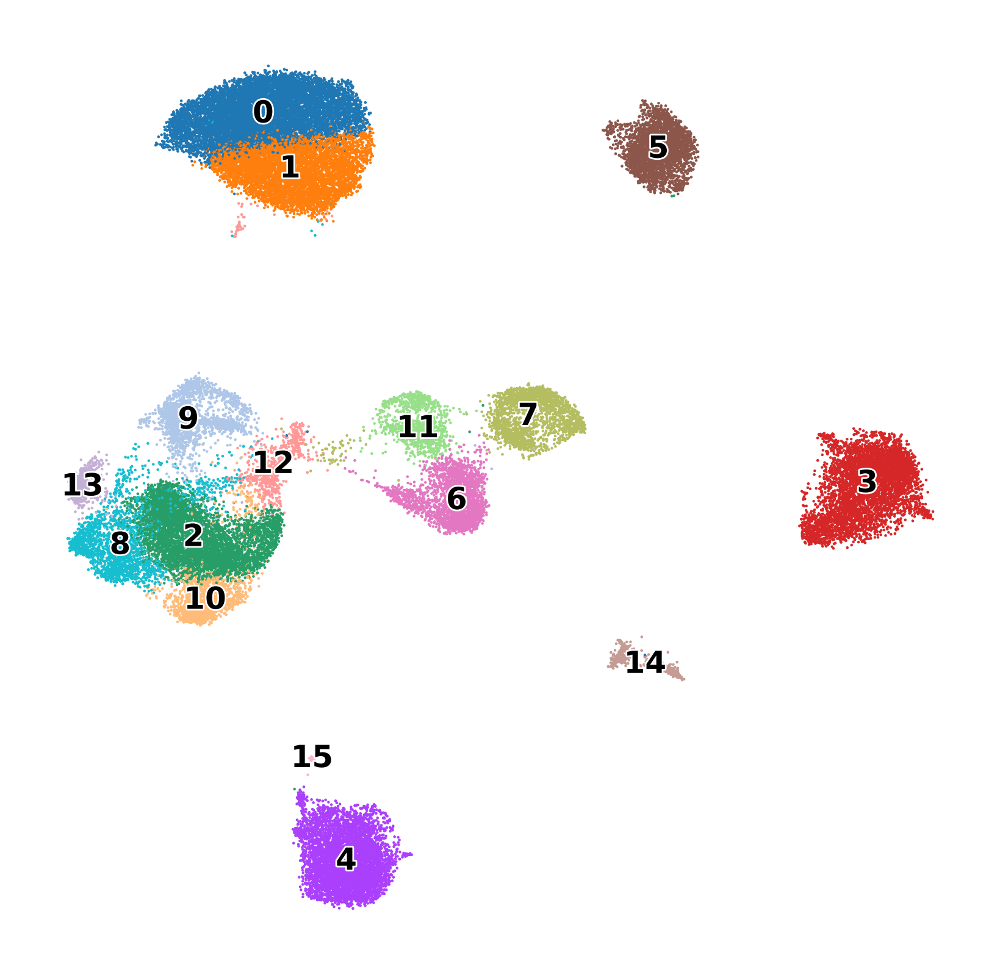

In [50]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['leiden'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=1, 
    legend_fontsize=9, 
    title='',
    save='_EC_leiden.pdf'
)


categories: 0, 1, 2, etc.
var_group_labels: Oligodendrocyte, Astrocyte, Microglia, etc.


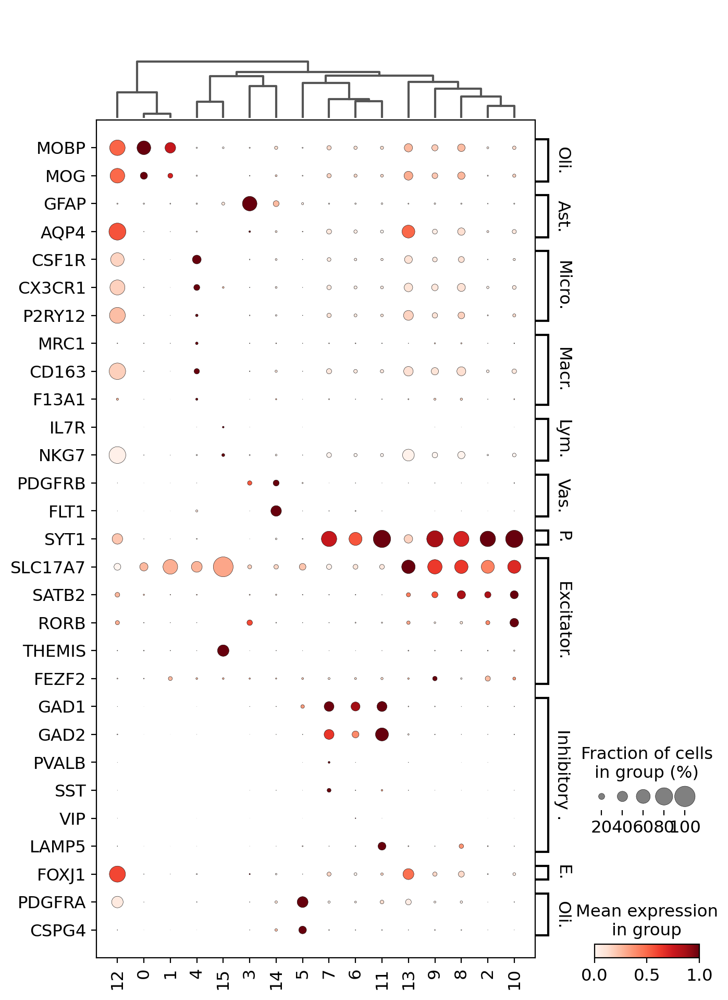

In [51]:
marker_dict = {
    'Oligodendrocyte': ['MOBP', 'MOG'],
    'Astrocyte': ['GFAP', 'AQP4'],
    'Microglia': ['CSF1R', 'CX3CR1', 'P2RY12'],
    'Macrophage': ['MRC1', 'CD163', 'F13A1'],
    'Lymphocytes': ['IL7R', 'NKG7'],
    'Vasculature': ['PDGFRB', 'FLT1'],
    'Pan-neuronal': ['SYT1'],
    'Excitatory Neuron': ['SLC17A7', 'SATB2', 'RORB', 'THEMIS', 'FEZF2'],
    'Inhibitory Neuron': ['GAD1', 'GAD2', 'PVALB', 'SST', 'VIP', 'LAMP5'],
    'Ependyma' : ['FOXJ1'], # not expressed
    'Oligodendrocyte Progenitor': ['PDGFRA', 'CSPG4'],
}

sc.set_figure_params(dpi=100)
sc.pl.dotplot(
    adata, marker_dict, 'leiden', 
    dendrogram=True, 
    standard_scale='var', swap_axes=True
)


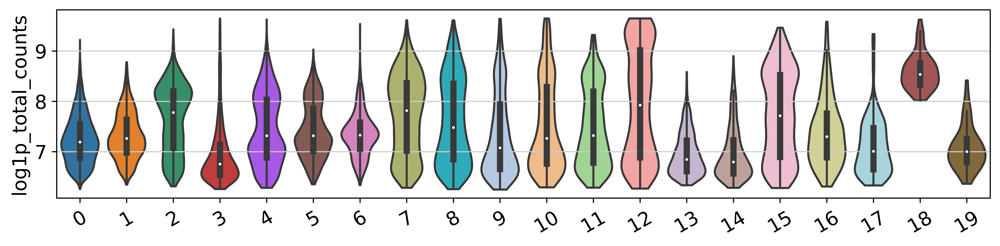

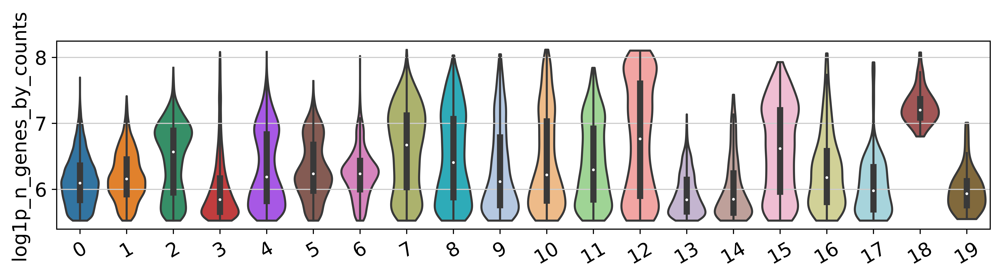

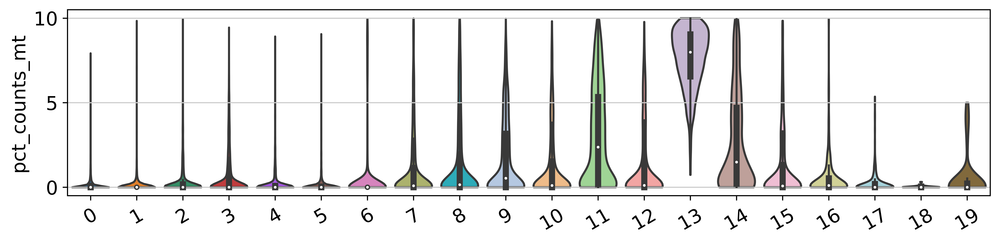

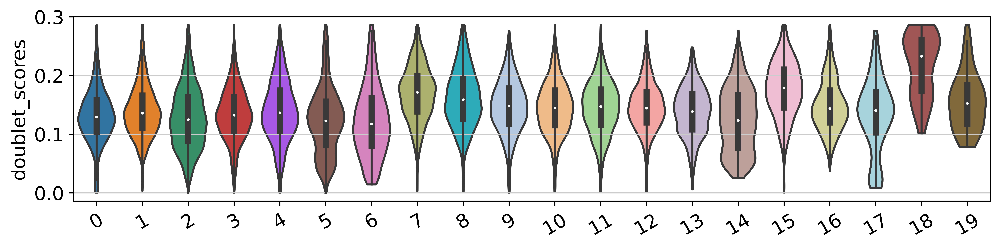

In [76]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'log1p_n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'doublet_scores'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)

In [52]:
adata.obs.leiden.value_counts()

0     8672
1     5801
2     5168
3     5064
4     5009
5     3169
6     2257
7     2087
8     2085
9     2022
10    1527
11    1153
12     703
13     511
14     451
15      26
Name: leiden, dtype: int64

## annotation

In [53]:

# load cluster anno df 
anno_df = pd.read_csv('data/Leng_EC_2021_leiden_clusters.csv')

anno_df.leiden = anno_df.leiden.astype(str)
temp = adata.obs.merge(
    anno_df, how='left',
    on = 'leiden')

adata.obs['cell_type'] = temp['cell_type'].astype(str).to_list()
adata.obs['annotation'] = temp['annotation'].astype(str).to_list()



In [54]:
# remove doublet clusters
clusters_to_remove = ['Doublet']
adata = adata[~adata.obs.annotation.isin(clusters_to_remove)]


In [55]:
# re-make umap 
sc.tl.umap(adata, min_dist=0.35, method='umap')

Trying to set attribute `.uns` of view, copying.


... storing 'cell_type' as categorical
... storing 'annotation' as categorical


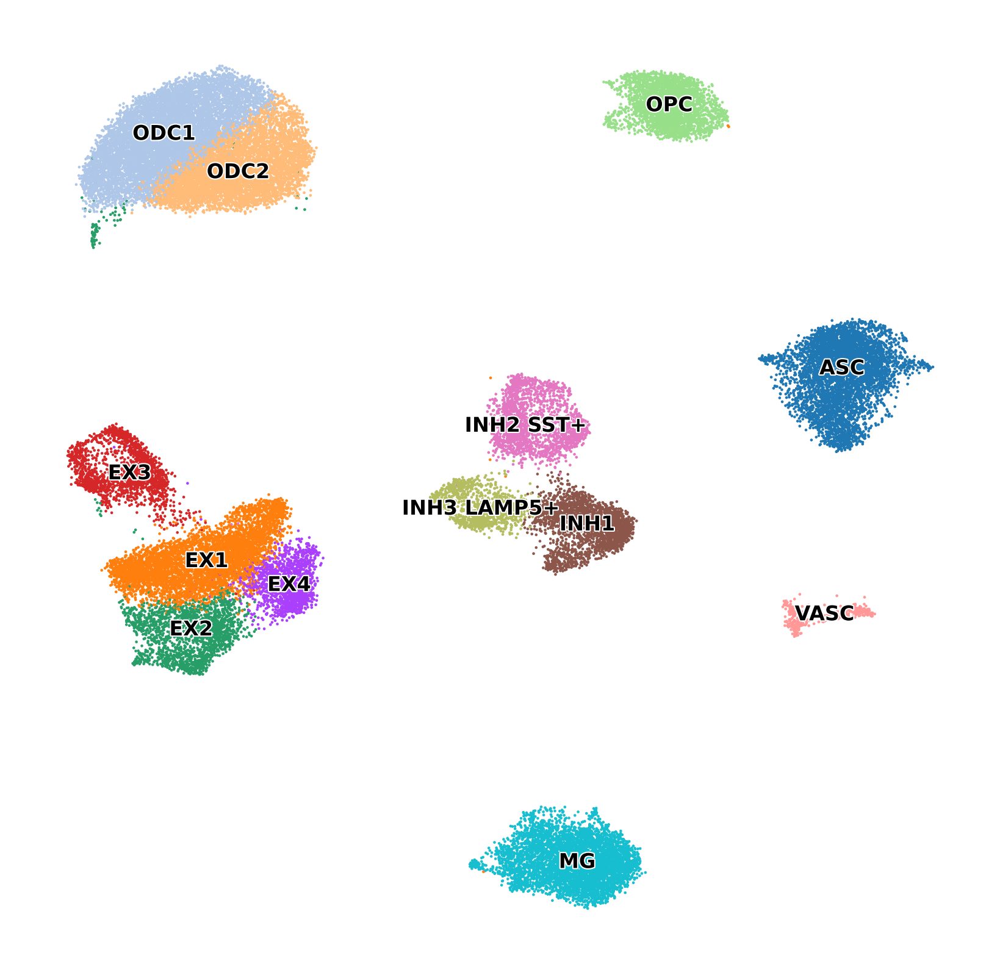

In [56]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap(
    adata, 
    color=['annotation'],
    frameon=False, 
    legend_loc='on data', 
    legend_fontoutline=.75, 
    legend_fontsize=6, 
    title='',
    save='_EC_annotation.pdf'
)


## Save Processed dataset:

In [57]:
# write obs table 
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]
adata.obs.to_csv('{}/Leng_2021_EC_processed_obs.csv'.format(data_dir))

# write var table:
adata.var.to_csv('{}/Leng_2021_EC_processed_var.csv'.format(data_dir))

In [58]:
# write anndata:
adata.write_h5ad('{}/Leng_2021_EC_processed.h5ad'.format(data_dir))

In [59]:

# save the sparse matrix for Seurat:
X = adata.layers['counts']
X = scipy.sparse.csr_matrix.transpose(X)
io.mmwrite('{}/Leng_2021_EC_counts.mtx'.format(data_dir), X)


In [60]:
# save the Harmony Matrix for Seurat:
pd.DataFrame(adata.obsm['X_pca_harmony']).to_csv('{}/Leng_2021_EC_processed_harmony.csv'.format(data_dir))
